# Percentage Changes in Mobility
## Last Updated: 03-07-2021

In [1]:
# Importing the necessary libraries

import pandas as pd
import numpy as np
import os
import seaborn as sns
import matplotlib.pyplot as plt
import datetime
from sklearn.model_selection import train_test_split
import json
import warnings
from os import listdir
from os.path import isfile,join
import datetime
import requests
from sklearn.metrics import r2_score, accuracy_score
import catboost
import matplotlib as mpl
import sys
sys.path.append('.')
from src.utils import collect_data
from src.utils import eda
import warnings
warnings.filterwarnings('ignore')

In [16]:
import importlib
importlib.reload(eda)
collect_datasets = collect_data.DataCollection()
data_analysis = eda.DataAnalysis()

In [3]:
df_mobility = collect_datasets.get_mobility_data(download=False)
df_county_spending = collect_datasets.get_spend_data()
df_covid = collect_datasets.combine_covid_data()
df_weather = collect_datasets.combine_weather(df_mobility,df_covid)
df_county = collect_datasets.combined_county_data()

In [4]:
def get_df_2019(df_weather, df_mob,df_covid,df_demographics,year=2019):
    df_mob = df_mob.dropna()
    thr_date = datetime.datetime.strptime('2020-01-01', '%Y-%m-%d')
    covid_date = '2020-03-15'
    if year==2020:
        df_mob_prep = pd.merge(left = df_mob, right = df_covid, on = ['fips', 'date'], how='inner')
        df_mob_prep = df_mob_prep[df_mob_prep.date >=thr_date]
    elif year =='covid':
        df_mob_prep = pd.merge(left = df_mob, right = df_covid, on = ['fips', 'date'], how='inner')
        df_mob_prep = df_mob_prep[(df_mob_prep.date >=covid_date)&(df_mob_prep.date <'2021-01-01')]
    else:
        df_mob_prep = df_mob[(df_mob.date < thr_date)]
        
    df_mob_weather = pd.merge(left = df_mob_prep, right = df_weather, on =['date', 'fips'])

    return df_mob_weather

In [5]:
df_2019 = get_df_2019(df_weather, df_mobility, df_covid, df_demographics=df_county)
df_2019_fil = df_2019[df_2019['State Postal Code'] != 'AK']
df_covid_mob = get_df_2019(df_weather, df_mobility, df_covid, df_demographics=df_county,year = 'covid')
df_covid_fil = df_covid_mob[df_covid_mob['State Postal Code'] != 'AK']


In [6]:
def create_pct_change_df(month, df_covid,df_2019,target_cols):
    df_covid_month = df_covid[df_covid['month'] == month]
    df_2019_month = df_2019[df_2019['month'] == month]

    df_covid_fips_gr_month = df_covid_month.groupby(['fips'])[target_cols].mean().reset_index()
    df_2019_fil_gr_month = df_2019_month.groupby(['fips'])[target_cols].mean().reset_index()
    df_covid_pct_changes_month = df_covid_fips_gr_month.join(df_2019_fil_gr_month.set_index('fips'),on='fips',
                                                      lsuffix='_covid',rsuffix='_2019',how='inner')
    for col in target_cols:
        df_covid_pct_changes_month[month +'_pct_change_'+col] = (df_covid_pct_changes_month[col+'_2019'] \
                                                         - df_covid_pct_changes_month[col+'_covid'])*100\
                                                        / (df_covid_pct_changes_month[col+'_2019'])
        df_covid_pct_changes_month = df_covid_pct_changes_month.drop(columns = [col+'_covid', col+'_2019'])
    
    return df_covid_pct_changes_month

    

In [14]:
months = ['March', "April", 'May','June','July','August','September','October','November', 'December']
target_cols = [col for col in df_mobility.columns if 'Number' in col][5:8]
df_pct_change = pd.DataFrame()
df_pct_change['fips'] = df_mobility['fips'].unique()
for month in months:

    df_pct_change_month  = create_pct_change_df(month, df_covid_fil,df_2019_fil,target_cols=target_cols)
    df_pct_change = df_pct_change.join(df_pct_change_month.set_index('fips'),on='fips')
    df_pct_change = df_pct_change.dropna()
mean_cols=[]
for col in target_cols:
    cols = [c for c in df_pct_change.columns if col in c]
    df_pct_change['Mean_'+col] = df_pct_change[cols].sum(axis=1)/len(months)
    mean_cols.append('Mean_'+col)
data_analysis.plot_map(mean_cols,df_pct_change,cmap='inferno',q_filter=True,filter_level=[0.01, 0.99])


KeyboardInterrupt: 

In [17]:
months = ['March', "April", 'May','June','July','August','September','October','November', 'December']
target_cols = ['trips_per_person','mobility_per_person','pct_not_home']
df_pct_change = pd.DataFrame()
df_pct_change['fips'] = df_mobility['fips'].unique()
for month in months:

    df_pct_change_month  = create_pct_change_df(month, df_covid_fil,df_2019_fil,target_cols=target_cols)
    df_pct_change = df_pct_change.join(df_pct_change_month.set_index('fips'),on='fips')
    df_pct_change = df_pct_change.dropna()
mean_cols=[]
for col in target_cols:
    cols = [c for c in df_pct_change.columns if col in c]
    df_pct_change['Mean_'+col] = df_pct_change[cols].sum(axis=1)/len(months)
#     mean_cols.append('Mean_'+col)
    fname = 'mean_pct_change_'+col
    m = data_analysis.plot_map(['Mean_'+col],df_pct_change,cmap='inferno',save_op=True,name=fname,
                           q_filter=True,filter_level=[0.01, 0.995])


Saving file at  ./data/output/maps//2021-03-08_mean_pct_change_trips_per_person.html
Saving file at  ./data/output/maps//2021-03-08_mean_pct_change_mobility_per_person.html
Saving file at  ./data/output/maps//2021-03-08_mean_pct_change_pct_not_home.html


### Weekend Percentage Changes in Mobility - Month COVID vs 2019 May

In [10]:
month = 'May'
df_covid_fil_month = df_covid_fil[df_covid_fil['month'] != month]

target_cols = [col for col in df_mobility.columns if 'trips_' in col or 'home' in col or 'mobility' in col]
df_covid_fips_weekday = df_covid_fil_month.groupby(['fips','weekend'])[target_cols].mean().reset_index()
df_covid_fips_weekday_pct_change = (df_covid_fips_weekday.groupby('fips')[target_cols].apply(pd.Series.pct_change)) *100
df_covid_fips_weekday_pct_change['fips'] = df_covid_fips_weekday['fips']

df_covid_fips_weekday_pct_change = df_covid_fips_weekday_pct_change.dropna()
data_analysis.plot_map(target_cols,df_covid_fips_weekday_pct_change,cmap='bwr',q_filter=True,filter_level=[0.005, 0.995])

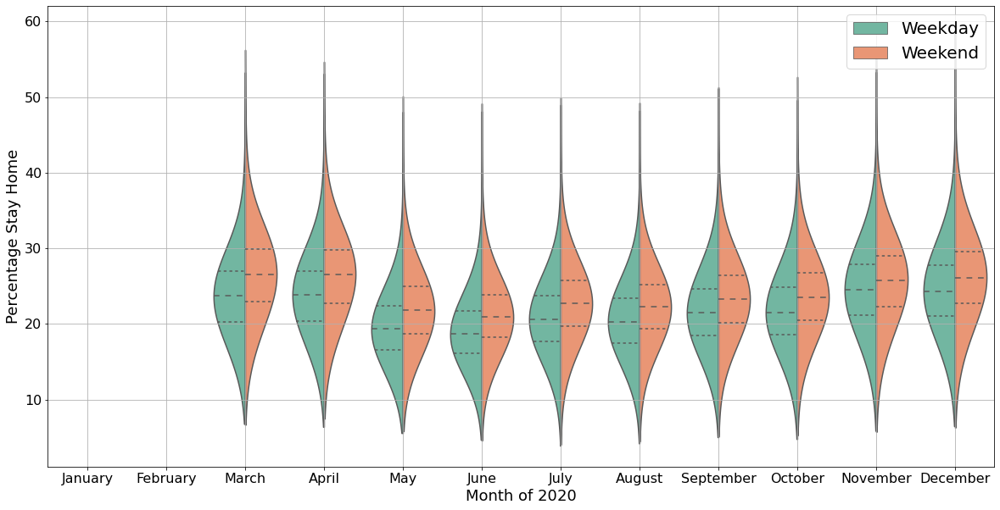

In [44]:
df_fips_month_pct_stay_home_covid = df_covid_fil.groupby(['fips','month','weekend'])['pct_stay_home'].mean().reset_index()
df_fips_month_pct_stay_home_2019 = df_2019_fil.groupby(['fips','month','weekend'])['pct_stay_home'].mean().reset_index()

order = ['January','February','March','April','May','June','July','August','September','October','November','December']
plt.figure(figsize=(20,10),facecolor='w')
sns.violinplot(data=df_fips_month_pct_stay_home_covid,hue='weekend',y='pct_stay_home',x='month',cut=0,
               split=True,scale='count',order= order,scale_hue=True,bw=0.8
               , palette="Set2", inner='quartile',saturation=0.75,labels=None)

plt.legend(fontsize=20)

plt.xticks(fontsize = 16)
plt.yticks(fontsize = 16)
plt.ylabel('Percentage Stay Home',fontsize = 18)
plt.xlabel('Month of 2020',fontsize = 18)
plt.grid()
data_analysis.save_fig('Percentage_population_home_COVID_monthly_weekday_weekend')

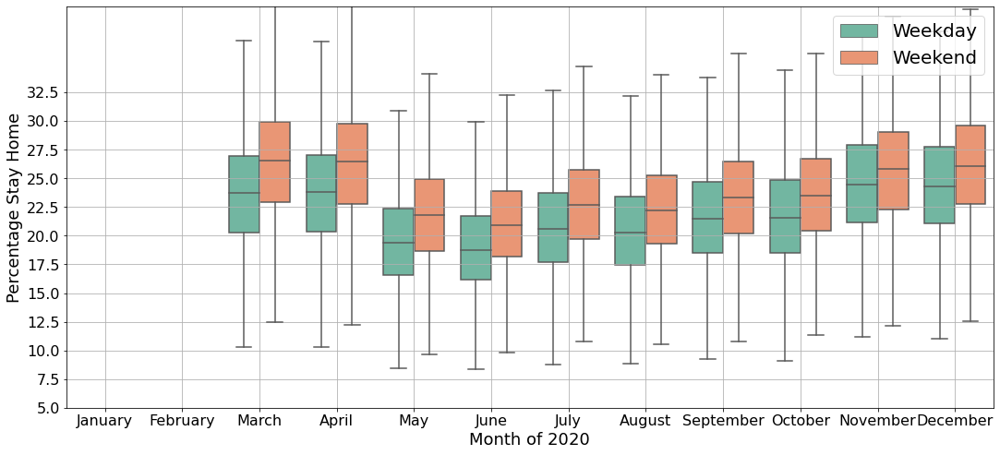

In [45]:
order = ['January','February','March','April','May','June','July','August','September','October','November','December']
plt.figure(figsize=(18,8))
sns.boxplot(data=df_fips_month_pct_stay_home_covid,hue='weekend',y='pct_stay_home',
            x='month',order=order,palette="Set2",fliersize=0)
plt.ylim(5,40)
plt.legend(loc = 'upper right',fontsize=20)

plt.xticks(fontsize = 16)
plt.yticks(np.arange(5,35,2.5),fontsize = 16)
plt.ylabel('Percentage Stay Home',fontsize = 18)
plt.xlabel('Month of 2020',fontsize = 18)
plt.grid()
data_analysis.save_fig('Percentage_population_home_COVID_monthly_weekday_weekend_bar')

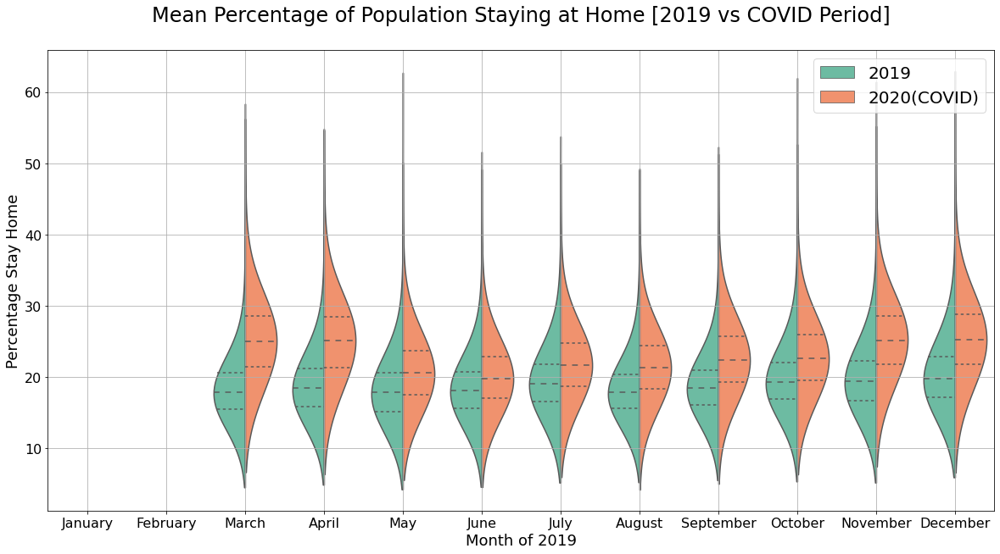

In [46]:
df_fips_month_merge = pd.merge(left = df_fips_month_pct_stay_home_2019,right = df_fips_month_pct_stay_home_covid, 
         on =['fips','month','weekend'], how='inner',suffixes = ('_2019','_2020(COVID)'))
df_fips_month_merge = df_fips_month_merge.melt(id_vars = ['fips','month','weekend'],
                         value_vars=['pct_stay_home_2019','pct_stay_home_2020(COVID)'],value_name='pct_stay_home',var_name='Period')
df_fips_month_merge['Period'] = df_fips_month_merge.Period.str.split('_', 3, expand=True)[3]
plt.figure(figsize=(20,10),facecolor='w')
sns.violinplot(data=df_fips_month_merge,hue='Period',y='pct_stay_home',x='month',cut=0,
               split=True,scale='count',order= order,scale_hue=True,bw=0.8
               , palette="Set2",
               inner='quartile',saturation=0.85,labels=None)

plt.legend(fontsize=20)

plt.xticks(fontsize = 16)
plt.yticks(fontsize = 16)
plt.ylabel('Percentage Stay Home',fontsize = 18)
plt.xlabel('Month of 2019',fontsize = 18)
plt.grid()
plt.title('Mean Percentage of Population Staying at Home [2019 vs COVID Period]\n',fontsize=24)
data_analysis.save_fig('Percentage_population_home_comparison_2020vs2019_monthly')

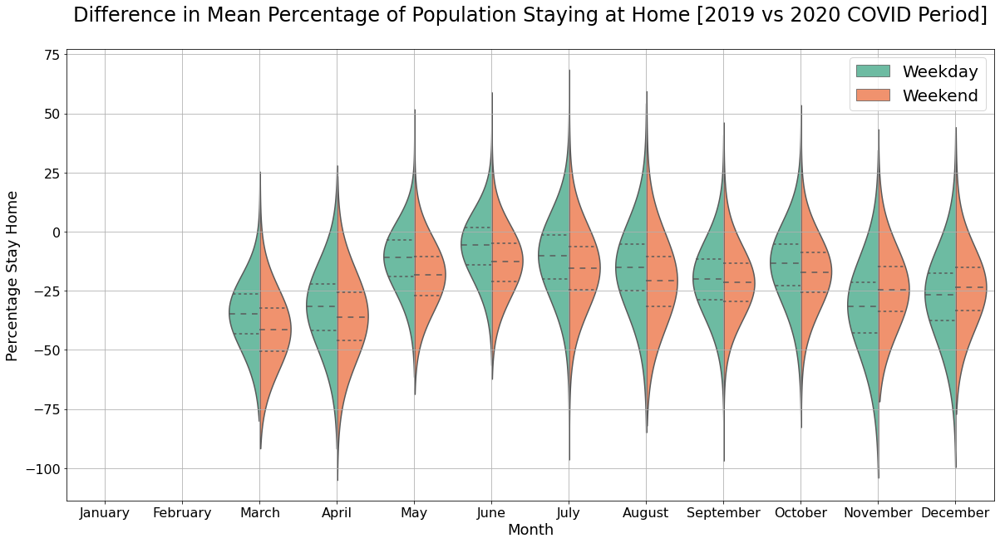

In [75]:
df_fips_month_diff = pd.merge(left = df_fips_month_pct_stay_home_2019,right = df_fips_month_pct_stay_home_covid, 
         on =['fips','month','weekend'], how='inner',suffixes = ('_2019','_covid'))

df_fips_month_diff['2019-COVID_diff'] = (df_fips_month_diff['pct_stay_home_2019'] - df_fips_month_diff['pct_stay_home_covid'])*100/df_fips_month_diff['pct_stay_home_2019'] 
plt.figure(figsize=(20,10))
sns.violinplot(data=df_fips_month_diff,hue='weekend',y='2019-COVID_diff',x='month',cut=0,
               split=True,scale='count',order= order,scale_hue=True,bw=0.8
               , palette="Set2",
               inner='quartile',saturation=0.85,labels=None)

plt.legend(fontsize=20)

plt.xticks(fontsize = 16)
plt.yticks(fontsize = 16)
plt.ylabel('Percentage Stay Home',fontsize = 18)
plt.xlabel('Month',fontsize = 18)
plt.grid()
plt.title('Difference in Mean Percentage of Population Staying at Home [2019 vs 2020 COVID Period]\n',fontsize=24)
data_analysis.save_fig('Percentage_population_home_difference_2019vs2020_monthly_wknd_wkday')
plt.show()


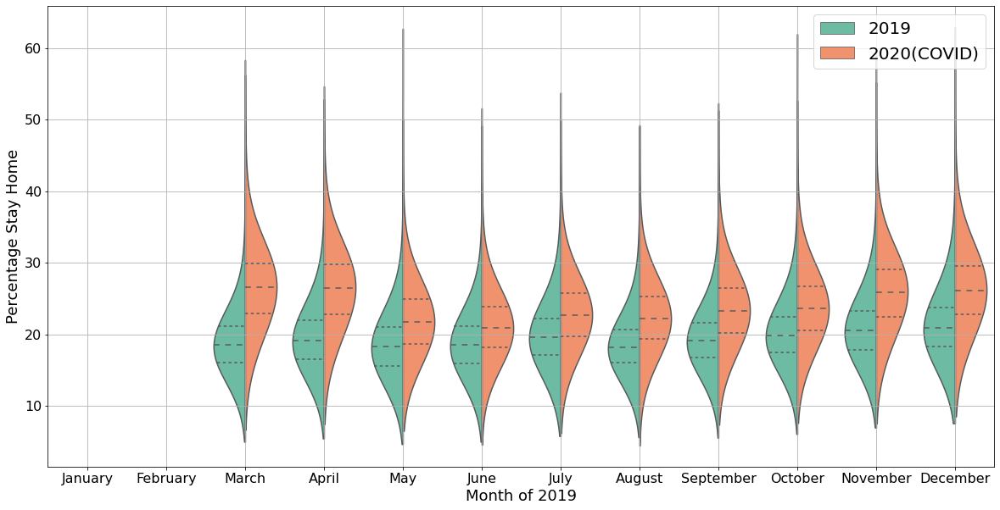

In [34]:
df_fips_month_merge_wkend = df_fips_month_merge[df_fips_month_merge.weekend == 'Weekend']
plt.figure(figsize=(20,10))
sns.violinplot(data=df_fips_month_merge_wkend,hue='Period',y='pct_stay_home',x='month',cut=0,
               split=True,scale='count',order= order,scale_hue=True,bw=0.8
               , palette="Set2",
               inner='quartile',saturation=0.85,labels=None)

plt.legend(fontsize=20)

plt.xticks(fontsize = 16)
plt.yticks(fontsize = 16)
plt.ylabel('Percentage Stay Home',fontsize = 18)
plt.xlabel('Month of 2019',fontsize = 18)
plt.grid()

In [29]:
df_fips_month_merge_wkday = df_fips_month_merge[df_fips_month_merge.weekend == 'Weekday']
plt.figure(figsize=(20,10))
sns.violinplot(data=df_fips_month_merge_wkday,hue='variable',y='period',x='month',cut=0,
               split=True,scale='count',order= order,scale_hue=True,bw=0.8
               , palette="Set2",
               inner='quartile',saturation=0.85,labels=None)

plt.legend(fontsize=20)

plt.xticks(fontsize = 16)
plt.yticks(fontsize = 16)
plt.ylabel('Percentage Stay Home',fontsize = 18)
plt.xlabel('Month of 2019',fontsize = 18)
plt.grid()

ValueError: Could not interpret input 'period'

<Figure size 1440x720 with 0 Axes>